In [34]:
import numpy as np
import pandas as pd
import torch

from matplotlib import pyplot as plt


import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

from torchvision import datasets, transforms
from torch.utils.data import DataLoader

from torchvision import transforms, models

import torch
from torchvision.models import vgg11, VGG11_Weights

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import seaborn as sns
import os
from PIL import Image

import random

import shutil
import pandas as pd
from sklearn.model_selection import train_test_split
from torchvision import transforms

# Автоматическое разделение с помощью Python

In [18]:
source_dir = r'C:\Users\Ary\BollywoodCelebrity\Bollywood_celeb_face_localized\bollywood_celeb_faces_0'
output_dir = r'C:\Users\Ary\BollywoodCelebrity\processed_dataset'

for split in ['train', 'test']:
    for class_name in os.listdir(source_dir):
        os.makedirs(os.path.join(output_dir, split, class_name), exist_ok=True)

for class_name in os.listdir(source_dir):
    
    class_dir = os.path.join(source_dir, class_name)
    
    files = os.listdir(class_dir)
    
    print(files)

    train_files, test_files = train_test_split(files, test_size=0.3, random_state=42)
   
    # val_files, test_files = train_test_split(temp_files, test_size=0.33, random_state=42)

    for split, split_files in zip(['train','test'], [train_files, test_files]):
        for file_name in split_files:
            src_path = os.path.join(class_dir, file_name)
            dst_path = os.path.join(output_dir, split, class_name, file_name)
            print(src_path, dst_path, sep = '\n')
            shutil.copy(src_path, dst_path)

print("Данные успешно разделены!")


['Aamir.100.jpg', 'Aamir.101.jpg', 'Aamir.103.jpg', 'Aamir.105.jpg', 'Aamir.106.jpg', 'Aamir.111.jpg', 'Aamir.112.jpg', 'Aamir.113.jpg', 'Aamir.115.jpg', 'Aamir.116.jpg', 'Aamir.118.jpg', 'Aamir.120.jpg', 'Aamir.121.jpg', 'Aamir.123.jpg', 'Aamir.125.jpg', 'Aamir.128.jpg', 'Aamir.129.jpg', 'Aamir.130.jpg', 'Aamir.132.jpg', 'Aamir.134.jpg', 'Aamir.142.jpg', 'Aamir.144.jpg', 'Aamir.151.jpg', 'Aamir.153.jpg', 'Aamir.158.jpg', 'Aamir.161.jpg', 'Aamir.163.jpg', 'Aamir.164.jpg', 'Aamir.167.jpg', 'Aamir.169.jpg', 'Aamir.170.jpg', 'Aamir.171.jpg', 'Aamir.173.jpg', 'Aamir.179.jpg', 'Aamir.183.jpg', 'Aamir.185.jpg', 'Aamir.190.jpg', 'Aamir.192.jpg', 'Aamir.217.jpg', 'Aamir.228.jpg', 'Aamir.234.jpg', 'Aamir.256.jpg', 'Aamir.264.jpg', 'Aamir.289.jpg', 'Aamir.314.jpg', 'Aamir.344.jpg', 'Aamir.356.jpg', 'Aamir.40.jpg', 'Aamir.41.jpg', 'Aamir.44.jpg', 'Aamir.46.jpg', 'Aamir.47.jpg', 'Aamir.472.jpg', 'Aamir.478.jpg', 'Aamir.51.jpg', 'Aamir.52.jpg', 'Aamir.559.jpg', 'Aamir.56.jpg', 'Aamir.58.jpg', 'Aami

# Создание датасета

In [23]:

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

train_dataset = datasets.ImageFolder(root='processed_dataset/train', transform=transform)
test_dataset = datasets.ImageFolder(root='processed_dataset/test', transform=transform)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# Загрузка модели

## Function

In [30]:

def plot_training_history(history):
    epochs = range(1, len(history["train_loss"]) + 1)
    
    # Loss plot
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(epochs, history["train_loss"], label="Train Loss")
    plt.plot(epochs, history["val_loss"], label="Validation Loss")
    plt.title("Loss over Epochs")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    
    # Metrics plot
    plt.subplot(1, 2, 2)
    plt.plot(epochs, history["val_accuracy"], label="Accuracy")
    plt.plot(epochs, history["val_precision"], label="Precision")
    plt.plot(epochs, history["val_recall"], label="Recall")
    plt.plot(epochs, history["val_f1"], label="F1-Score")
    plt.title("Metrics over Epochs")
    plt.xlabel("Epochs")
    plt.ylabel("Metrics")
    plt.legend()
    
    plt.tight_layout()
    plt.show()

In [31]:


def train_model(model, train_loader, val_loader, criterion, optimizer, epochs=10):
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    model.to(device)
    
    history = {
        "train_loss": [],
        "val_loss": [],
        "val_accuracy": [],
        "val_precision": [],
        "val_recall": [],
        "val_f1": [],
    }
    
    for epoch in range(epochs):
        # Training phase
        model.train()
        train_loss = 0
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
        
        # Validation phase
        model.eval()
        val_loss = 0.0
        all_preds = []
        all_labels = []
        
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                val_loss += loss.item()
                
                # Collect predictions and true labels for metrics
                _, preds = torch.max(outputs, 1)
                all_preds.extend(preds.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())
        
        # Calculate metrics
        accuracy = accuracy_score(all_labels, all_preds)
        precision = precision_score(all_labels, all_preds, average="weighted", zero_division=0)
        recall = recall_score(all_labels, all_preds, average="weighted", zero_division=0)
        f1 = f1_score(all_labels, all_preds, average="weighted", zero_division=0)
        
        # Store metrics in history
        history["train_loss"].append(train_loss / len(train_loader))
        history["val_loss"].append(val_loss / len(val_loader))
        history["val_accuracy"].append(accuracy)
        history["val_precision"].append(precision)
        history["val_recall"].append(recall)
        history["val_f1"].append(f1)
        
        print(f"Epoch {epoch+1}/{epochs}")
        print(f"Train Loss: {train_loss / len(train_loader):.4f}")
        print(f"Val Loss: {val_loss / len(val_loader):.4f}")
        print(f"Val Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1-Score: {f1:.4f}")
    
    # Plot metrics
    plot_training_history(history)

In [33]:

def evaluate_model(model, data_loader):
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    model.to(device)
    model.eval()
    
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for images, labels in data_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            preds = torch.argmax(outputs, dim=1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    accuracy = accuracy_score(all_labels, all_preds)
    precision = precision_score(all_labels, all_preds, average='macro')
    recall = recall_score(all_labels, all_preds, average='macro')
    f1 = f1_score(all_labels, all_preds, average='macro')
    cm = confusion_matrix(all_labels, all_preds)
    
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1-Score: {f1:.4f}")
    
    # Визуализация confusion matrix
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()


## Инициализация и обучение

In [39]:
class FaceClassifier(nn.Module):
    def __init__(self, num_classes):
        super(FaceClassifier, self).__init__()
        self.model = models.resnet50(pretrained=True)
        self.model.fc = nn.Linear(self.model.fc.in_features, num_classes)
    
    def forward(self, x):
        return self.model(x)

# Инициализация модели
num_classes = 33  # Количество классов дефектов
model = FaceClassifier(num_classes)
model = model.to('cuda' if torch.cuda.is_available() else 'cpu')

C:\Users\Ary\anaconda3\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Ary\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/5
Train Loss: 2.8631
Val Loss: 2.1899
Val Accuracy: 0.3661, Precision: 0.4492, Recall: 0.3661, F1-Score: 0.3333
Epoch 2/5
Train Loss: 1.2926
Val Loss: 1.5470
Val Accuracy: 0.5569, Precision: 0.6221, Recall: 0.5569, F1-Score: 0.5398
Epoch 3/5
Train Loss: 0.3649
Val Loss: 1.1315
Val Accuracy: 0.6797, Precision: 0.7172, Recall: 0.6797, F1-Score: 0.6802
Epoch 4/5
Train Loss: 0.1123
Val Loss: 0.9040
Val Accuracy: 0.7422, Precision: 0.7542, Recall: 0.7422, F1-Score: 0.7411
Epoch 5/5
Train Loss: 0.0622
Val Loss: 0.8636
Val Accuracy: 0.7533, Precision: 0.7692, Recall: 0.7533, F1-Score: 0.7550


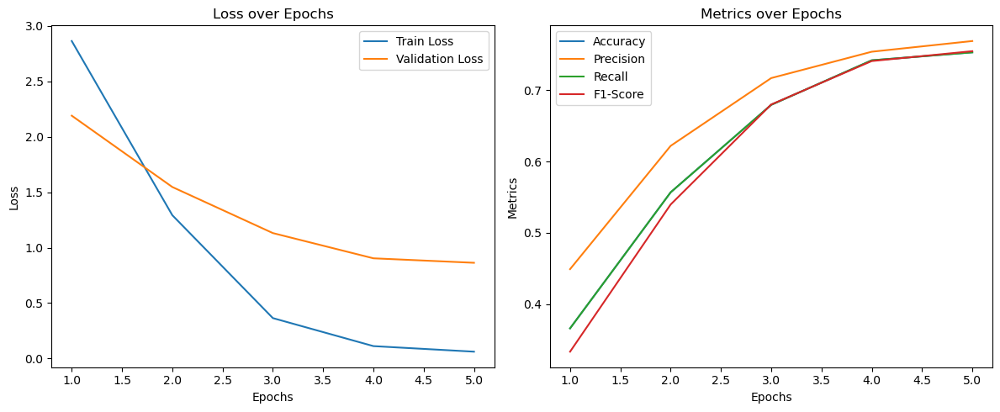

In [40]:
# Инициализация модели
# num_classes = 33  # Количество классов дефектов
# model = vgg11(weights=None)
# model.classifier[6] = torch.nn.Linear(in_features=4096, out_features=num_classes)
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# model = model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)

train_model(model, train_loader, test_loader, criterion, optimizer, epochs=5)

## Оценка модели

In [50]:
def visualize_predictions(dataset, model, class_names, device, num_images=9):
    """
    Параметры:
    - dataset: об ъект Dataset с изображениями и метками.
    - model: обученная модель.
    - class_names: список имен классов.
    - device: устройство (например, "cpu" или "cuda").
    - num_images: количество изображений для отображения.
    """
    model.eval()  # Переключение в режим оценки
    images_shown = 0
    plt.figure(figsize=(10, 10))
    
    with torch.no_grad():
        for i in range(400, len(dataset)):
            if images_shown >= num_images:
                break
            
            # Получаем изображение и истинную метку
            image, true_label = dataset[i]
            image = image.to(device)
            true_label = int(true_label)
            
            # Предсказание модели
            output = model(image.unsqueeze(0))
            _, predicted_label = torch.max(output, 1)
            
            # Конвертация изображения для отображения
            image_to_show =  transforms.ToPILImage()(image.cpu())
            
            # Визуализация
            plt.subplot(int(num_images**0.5), int(num_images**0.5), images_shown + 1)
            plt.imshow(image_to_show)
            plt.axis('off')
            plt.title(
                f"True: {class_names[true_label]}\nPred: {class_names[predicted_label.item()]}", 
                color="green" if true_label == predicted_label else "red"
            )
            images_shown += 1
    
    plt.tight_layout()
    plt.show()


Accuracy: 0.7533
Precision: 0.7667
Recall: 0.7520
F1-Score: 0.7527


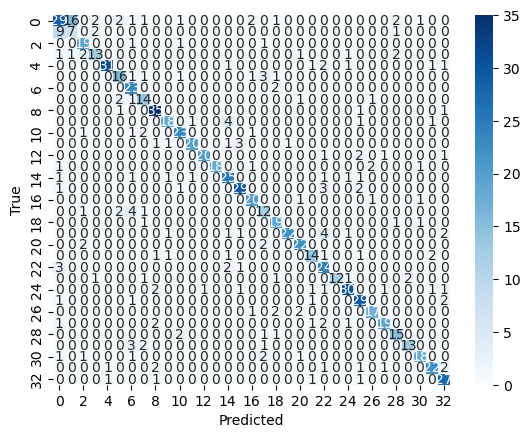

In [46]:
evaluate_model(model, test_loader)

In [43]:
class_names = os.listdir(source_dir)
class_names

['Aamir_Khan',
 'Abhay_Deol',
 'Abhishek_Bachchan',
 'Aftab_Shivdasani',
 'Aishwarya_Rai',
 'Ajay_Devgn',
 'Akshaye_Khanna',
 'Akshay_Kumar',
 'Alia_Bhatt',
 'Ameesha_Patel',
 'Amitabh_Bachchan',
 'Amrita_Rao',
 'Amy_Jackson',
 'Anil_Kapoor',
 'Anushka_Sharma',
 'Anushka_Shetty',
 'Arjun_Kapoor',
 'Arjun_Rampal',
 'Arshad_Warsi',
 'Asin',
 'Ayushmann_Khurrana',
 'Bhumi_Pednekar',
 'Bipasha_Basu',
 'Bobby_Deol',
 'Deepika_Padukone',
 'Disha_Patani',
 'Emraan_Hashmi',
 'Esha_Gupta',
 'Farhan_Akhtar',
 'Govinda',
 'Hrithik_Roshan',
 'Huma_Qureshi',
 'Ileana_DCruz']

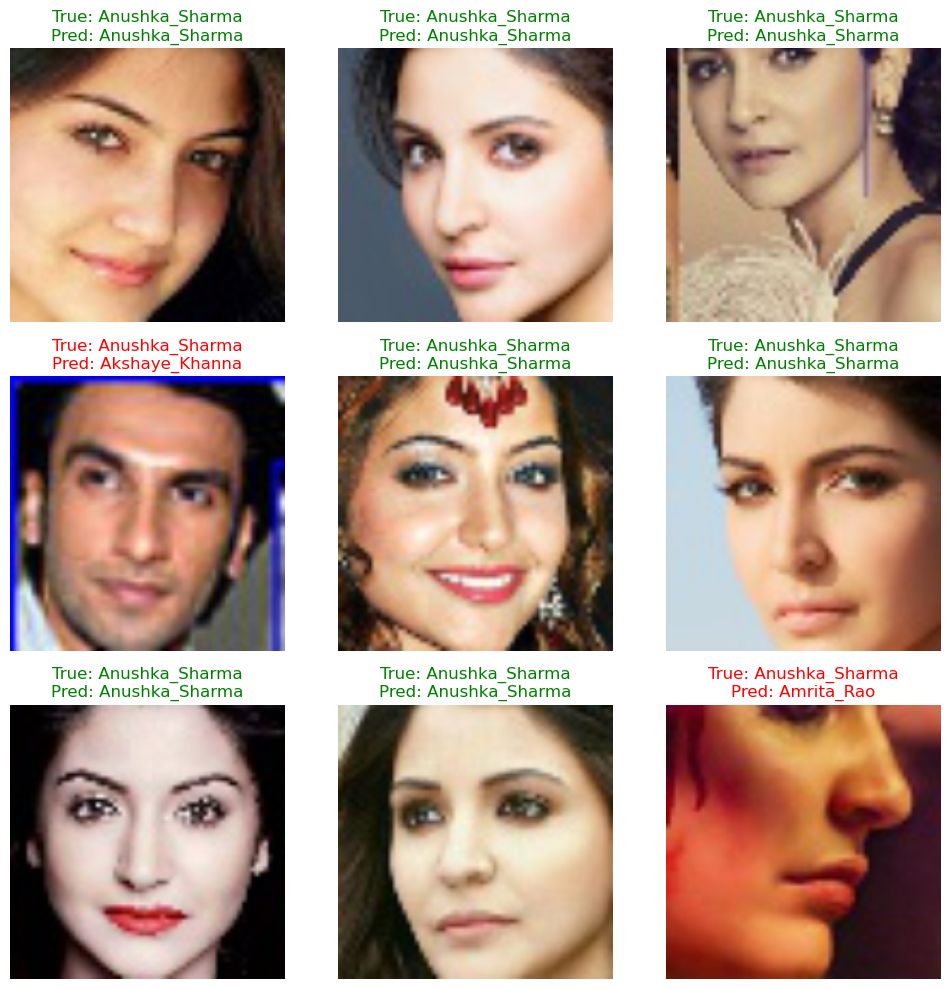

In [51]:
visualize_predictions(test_dataset, model, class_names, device)

## Загрузка собственного фото

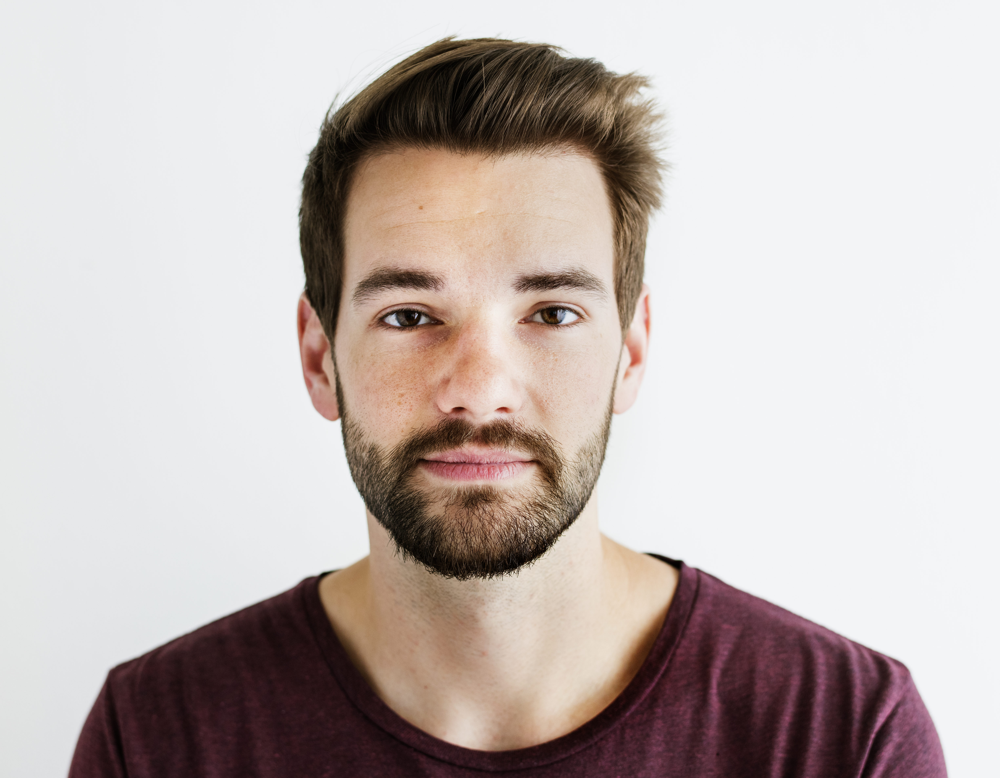

In [81]:
image_path = r'C:\Users\Ary\Pictures\Новая папка\portrait-of-white-man-isolated.jpg'
image = Image.open(image_path)
image

In [82]:

preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

input_tensor = preprocess(image)
input_batch = input_tensor.unsqueeze(0)  # Shape becomes [1, 3, 224, 224]
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
input_batch = input_batch.to(device)
model.eval()  
model = model.to(device)

with torch.no_grad():
    output = model(input_batch)

probabilities = torch.nn.functional.softmax(output[0], dim=0)

predicted_class = torch.argmax(probabilities).item()

print(f'Predicted Class: {class_names[predicted_class]}, {predicted_class}')


Predicted Class: Aamir_Khan, 0
